# Import Packages

In [445]:
%load_ext autoreload
%autoreload 2
import glob
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import geopandas
import geopy
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import linear_rainbow, het_breuschpagan
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error, make_scorer
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
import folium.plugins as plugins
import math
from math import sin, cos, sqrt, atan2, radians
from haversine import haversine
from itertools import combinations
%matplotlib inline
pd.set_option("display.max_columns", 200)
pd.set_option("display.max_rows", 200)
from useful_functions import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Read in the data  

In [446]:
files = glob.glob("data/raw/*.csv")
names = ['lookup', 'parcel', 'resbldg', 'rpsale']
dict_dfs = {}
for x,y in zip(names, files):
    dict_dfs[x] = pd.read_csv(y, dtype=str)
lookup_df = dict_dfs['lookup']
parcel_df = dict_dfs['parcel']
resbldg_df = dict_dfs['resbldg']
rpsale_df = dict_dfs['rpsale']

First with an explore of the dataframes one by one and see which columns could potentially be dropped, important to remember this project is going to be focussed on home improvements. For that reason it will be important to keep any columns that could pertain to home improvements, but in order to make the conclusions reached as accurate as possible, it may be necessary to keep some columns not related to home improvements in order to improve the overall accuracy of the model i.e Zip code.

In [447]:
parcel_df.head()

,Unnamed: 0,Major,Minor,PropName,PlatName,PlatLot,PlatBlock,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems
0,0,807841,0410,,SUMMER RIDGE DIV NO. 02,41,,6,25,22,SW,R,35,2,NaN,NaN,SAMMAMISH,2187,R4,1,1,2,7424,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
1,2,755080,0015,,SANDER'S TO GILMAN PK & SALMON BAY,3,1,3,25,11,NW,R,19,1,NaN,NaN,SEATTLE,0010,SF 5000,1,1,2,5000,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
2,3,888600,0135,,VASHON GARDENS ADD,21,,3,22,8,NE,R,100,3,NaN,NaN,KING COUNTY,4055,RA5,1,1,2,277041,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
3,6,022603,9181,,NaN,,,3,26,2,NW,R,1,1,NaN,NaN,SHORELINE,2263,R6,1,1,2,10560,2,2,4,0,1,0,0,0,False,0,2,0,2,0,2,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
4,7,229670,0160,,ELDORADO NORTH,16,,5,26,19,SW,R,37,2,NaN,NaN,KIRKLAND,1708,RSA 6,1,1,2,9853,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N


In [448]:
resbldg_df.head()

,Major,Minor,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost
0,009800,0720,1,1,27719 SE 26TH WAY 98075,27719,,SE,26TH,WAY,,98075,2,11,0,1970,0,2130,0,0,0,4100,0,0,0,0,750,,0,0,0,5,2,0,,4,1,0,3,3,0,0,0,2001,0,0,0,0,3,0
1,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0
2,009830,0020,1,1,1715 298TH CRESENT SE,1715,,,298TH CRESENT,,SE,NaN,2,10,0,2520,0,2560,0,0,0,5080,0,0,0,0,1020,,360,0,270,5,2,0,,4,0,0,5,1,0,0,0,2017,0,0,0,0,3,0
3,009830,0160,1,1,1861 297TH WAY SE 98024,1861,,,297TH,WAY,SE,98024,2,10,0,2210,0,1860,0,0,0,4070,0,0,0,0,1000,N,690,0,0,5,2,0,N,4,1,0,3,2,0,0,0,2013,0,0,0,0,3,0
4,010050,0180,1,1,35410 25TH PL S 98003,35410,,,25TH,PL,S,98003,2,7,0,910,0,700,0,0,0,1610,0,0,0,0,440,,60,0,0,5,2,0,,3,1,1,1,1,0,0,0,1994,0,0,0,0,4,0


In [449]:
rpsale_df.head()

,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot,PlatBlock,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning
0,2857854,198920,1430,03/28/2017,0,20170410000541,,,,,,,AD APARTMENTS LLC ...,SEATTLE CITY OF ...,3,7,15,N,N,N,N,16,2,20 31
1,2743355,638580,0110,07/14/2015,190000,20150715002686,,,,,,,GINGRICH AUDREY B ...,NATION FRED I ...,3,6,3,N,N,N,N,1,8,15
2,2999169,919715,0200,07/08/2019,192000,20190712001080,,,,,,,WAGNERESTATES LLC ...,SCHAFFER CORBIN ...,3,2,3,N,N,N,N,1,3,
3,2841697,894677,0240,12/21/2016,818161,20161228000896,,,,,,,QUADRANT CORPORATION ...,KANG JING ...,2,6,3,N,N,N,N,1,8,
4,2826129,445872,0260,10/03/2016,0,20161004000511,,,,,,,MARCH CARL J + SUSAN A ...,MARCH CARL J + SUSAN A REVOCABLE LIVING TRUST ...,3,2,15,N,N,N,N,18,3,18 31


In [450]:
lookup_df.head()

,LUType,LUItem,LUDescription
0,1,1,LAND ONLY ...
1,1,10,Land with new building ...
2,1,11,"Household, single family units ..."
3,1,12,"Multiple family residence (Residential, 2-4 un..."
4,1,13,"Multiple family residence (Residential, 5+ uni..."


Looks like it will be possible to merge the first 3 dataframes on Major and Minor. The last dataframe is a look up table which contains important information pertaining to various features of the properties.

For each dataframe I will combine the Major and Minor columns, creating an 'id' column, I will then merge the dataframes on this.

In [451]:
for df in [parcel_df, resbldg_df, rpsale_df]:
    concat_col(df, 'id', 'Major', 'Minor')

Ensure this has worked successfully, print the first 3 entries for each df.

In [452]:
for df in [parcel_df, resbldg_df, rpsale_df]:
    print(df[['Major', 'Minor', 'id']][:3])

    Major Minor          id
0  807841  0410  8078410410
1  755080  0015  7550800015
2  888600  0135  8886000135
    Major Minor          id
0  009800  0720  0098000720
1  009802  0140  0098020140
2  009830  0020  0098300020
    Major Minor          id
0  198920  1430  1989201430
1  638580  0110  6385800110
2  919715  0200  9197150200


Time to merge the dataframes and start cleaning it as a whole

In [453]:
merge_df = resbldg_df.merge(parcel_df, on='id', how='inner')
total_df = merge_df.merge(rpsale_df, how='left', on='id')

Time to explore the merged dataframe

In [454]:
total_df.shape

(251300, 157)

A lot of data! Hopefully some of these rows and columns can be cut down. First, remembering the brief of this project was to use data from 2019 to inform clients of home improvements. I will cut out any house sale that isn't from 2019.

In [455]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning
0,009800,0720,1,1,27719 SE 26TH WAY 98075,27719,,SE,26TH,WAY,,98075,2,11,0,1970,0,2130,0,0,0,4100,0,0,0,0,750,,0,0,0,5,2,0,,4,1,0,3,3,0,0,0,2001,0,0,0,0,3,0,0098000720,71581,009800,0720,,ALDARRA DIV NO. 01,72,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,16647,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,1,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2936583,009800,0720,06/14/2018,1300000,20180618000684,,,,,,,AYRES DOUGLAS W ...,HIGGIE JOHN ...,11,6,3,N,N,N,N,1,8,
1,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0,0098020140,68023,009802,0140,,ALDARRA DIV NO 03,14,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,7221,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3046924,009802,0140,04/17/2020,0,20200515000525,,,,,,,HOVIS WILLIAM ...,HOVIS WILLIAM+HOVIS REVOCABLE LIVING TRUST WIL...,11,6,15,N,N,N,N,18,8,
2,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0,0098020140,68023,009802,0140,,ALDARRA DIV NO 03,14,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,7221,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3046923,009802,0140,04/17/2020,0,20200515000524,,,,,,,HOVIS WILLIAM+LAURIE ...,HOVIS WILLIAM ...,11,6,15,N,N,N,N,18,8,
3,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0,0098020140,68023,009802,0140,,ALDARRA DIV NO 03,14,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,7221,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3046922,009802,0140,04/17/2020,0,20200515000523,,,,,,,HOVI

In [456]:
total_df['Date'] = pd.to_datetime(total_df['DocumentDate'], format='%m/%d/%Y')
total_df['Date'] = pd.DatetimeIndex(total_df['Date']).year
total_df = total_df[total_df['Date']==2019]

In [457]:
total_df.shape

(43838, 158)

Ok number of rows has been drastically reduced from ~251k to ~44k. Next I will filter out by property type, I want to focus on households. Using the look up table information, I know that property type 11 is household, single family unit. Property type 12 may be of interest too but depends on numbers.

In [458]:
total_df.PropertyType.value_counts()

11    26510
3     13186
2      1612
10     1338
0       322
12      286
1       256
14      137
91       61
5        32
18       23
45       16
13       13
4        12
83        8
59        5
96        4
99        3
6         3
19        3
94        2
65        2
51        1
15        1
23        1
86        1
Name: PropertyType, dtype: int64

In [459]:
for col in lookup_df.columns[:-1]:
    lookup_df[col] = lookup_df[col].str.strip().astype(int)
lookup(lookup_df, 1)

,LUType,LUItem,LUDescription
0,1,1,LAND ONLY ...
1,1,10,Land with new building ...
2,1,11,"Household, single family units ..."
3,1,12,"Multiple family residence (Residential, 2-4 un..."
4,1,13,"Multiple family residence (Residential, 5+ uni..."
5,1,14,Residential condominiums ...
6,1,15,Mobile home parks or courts ...
7,1,16,Hotels/motels ...
8,1,17,Institutional lodging ...
9,1,18,All other residential not elsewhere coded ...


Considering the overwhelming number of homes are type 11, the next two most populous categories refer to land sales. It makes sense to therefore restrict this analysis to property type 11.

In [460]:
total_df = total_df[total_df['PropertyType']=='11']

In [461]:
list(total_df.columns)

['Major_x',
 'Minor_x',
 'BldgNbr',
 'NbrLivingUnits',
 'Address',
 'BuildingNumber',
 'Fraction',
 'DirectionPrefix',
 'StreetName',
 'StreetType',
 'DirectionSuffix',
 'ZipCode',
 'Stories',
 'BldgGrade',
 'BldgGradeVar',
 'SqFt1stFloor',
 'SqFtHalfFloor',
 'SqFt2ndFloor',
 'SqFtUpperFloor',
 'SqFtUnfinFull',
 'SqFtUnfinHalf',
 'SqFtTotLiving',
 'SqFtTotBasement',
 'SqFtFinBasement',
 'FinBasementGrade',
 'SqFtGarageBasement',
 'SqFtGarageAttached',
 'DaylightBasement',
 'SqFtOpenPorch',
 'SqFtEnclosedPorch',
 'SqFtDeck',
 'HeatSystem',
 'HeatSource',
 'BrickStone',
 'ViewUtilization',
 'Bedrooms',
 'BathHalfCount',
 'Bath3qtrCount',
 'BathFullCount',
 'FpSingleStory',
 'FpMultiStory',
 'FpFreestanding',
 'FpAdditional',
 'YrBuilt',
 'YrRenovated',
 'PcntComplete',
 'Obsolescence',
 'PcntNetCondition',
 'Condition',
 'AddnlCost',
 'id',
 'Unnamed: 0',
 'Major_y',
 'Minor_y',
 'PropName',
 'PlatName',
 'PlatLot_x',
 'PlatBlock_x',
 'Range',
 'Township',
 'Section',
 'QuarterSection',


Ok, need to make this more useable, drop columns that will no longer be required.

Now I want to create an address column which can be used directly to find latitude and longitude of the property. The current Address column will not work with zip.

In [462]:
street_types = {'AVE': 'avenue', 'ST': 'street', 'PL': 'place', 'CT': 'court',\
                'DR': 'drive', 'LN': 'lane', 'RD':'road', 'BLVD': 'boulevard', 'PKWY': 'parkway',\
                'TER':'terrace', 'CRES': 'cresent', 'KY':'KY', 'WALK':'WALK'}

In [463]:
total_df.StreetType.str.strip().map(street_types)

10           street
11           street
17           avenue
21        boulevard
28           avenue
            ...    
251231       street
251258       avenue
251269        place
251295       street
251296       street
Name: StreetType, Length: 26510, dtype: object

In [464]:
total_df['address'] = total_df['BuildingNumber'].str.strip() + ' '+ total_df['DirectionPrefix'].str.strip()+' '\
                            + total_df['StreetName'].str.strip() + ' ' + total_df['StreetType']\
                            + ' ' + total_df['DirectionSuffix'].str.strip() + ',' + ' ' + total_df['DistrictName'].str.strip()\
                            + ', WA' + ', USA'

In [465]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date,address
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,AVE,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019,"12254 43RD AVE S, TUKWILA, WA, USA"
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,,LAKEVIEW,BLVD,E,98102,2,9,0,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0,0188000095,245005,018800,0095,Half of Duplex,ALLMOND ADD REPLAT,7,2,4,25,20,SE,R,13,3,NaN,NaN,SEATTLE,0010,LR2 (M),1,1,29,3117,2,2,4,1,1,0,0,0,False,0,0,0,0,0

time to check for duplicates, check how many are duplicated on sale price and id.

In [466]:
total_df.duplicated(subset=['SalePrice','id'], keep='last').sum()

1008

remove duplicates on Sale Price and id.

In [467]:
total_df.drop_duplicates(subset=['SalePrice','id'], keep='last', inplace=True)

Lets investigate the values in each column, this might aid me in deciding which ones to drop

In [468]:
for col in total_df.columns:
    print(col)
    print(total_df[col].value_counts())

Major_x
276760    90
762570    68
814136    63
510140    60
277060    57
          ..
283800     1
134630     1
856324     1
185600     1
545420     1
Name: Major_x, Length: 7494, dtype: int64
Minor_x
0040    484
0030    471
0020    438
0010    408
0060    407
       ... 
3470      1
1358      1
5195      1
1293      1
3268      1
Name: Minor_x, Length: 2751, dtype: int64
BldgNbr
1    25390
2      107
3        3
4        1
7        1
Name: BldgNbr, dtype: int64
NbrLivingUnits
1    25263
2      197
3       42
Name: NbrLivingUnits, dtype: int64
Address
                                   18
15425   2ND AVE NE  98155           4
18203  SE 272ND ST   98042          4
7932   28TH AVE SW  98126           3
13939   127TH PL NE  98034          3
                                   ..
13611   BEAR CREEK RD NE  98077     1
15505   PALATINE LN N  98133        1
8054   122ND AVE NE  98033          1
171   ORCAS AVE NE                  1
16609  NE 106TH ST   98052          1
Name: Address, Length: 24

Name: FpSingleStory, dtype: int64
FpMultiStory
0    17921
1     7159
2      389
3       26
4        5
5        2
Name: FpMultiStory, dtype: int64
FpFreestanding
0    23801
1     1639
2       62
Name: FpFreestanding, dtype: int64
FpAdditional
0    20906
1     4427
2      161
3        8
Name: FpAdditional, dtype: int64
YrBuilt
2018    729
1968    493
1967    450
1977    444
2005    431
1978    423
2019    416
2004    403
2006    399
2007    392
1959    386
1990    369
1987    364
1962    361
1979    355
2003    351
1955    335
1989    333
1954    318
1969    317
2008    311
2015    307
1961    306
1988    306
1966    303
1963    297
1960    295
1942    295
1947    293
1999    290
2001    290
1950    287
1986    284
1976    284
2016    282
1980    278
1958    268
2017    266
2014    264
1983    263
2002    263
2013    258
1953    254
1981    251
1951    244
1965    244
1994    243
1998    242
1984    241
1956    237
1952    236
1992    236
1991    233
1996    230
2000    227
1948    226
1

Name: LevyCode, Length: 324, dtype: int64
CurrentZoning
SF 5000        4191
R6             2018
R4             1490
RA5            1207
SF 7200        1139
               ... 
NC3P-95 (M)       1
O/C/MU            1
LOS               1
NBP               1
DT                1
Name: CurrentZoning, Length: 288, dtype: int64
HBUAsIfVacant
1     24969
6       499
0        14
21        8
9         4
15        4
14        2
13        1
16        1
Name: HBUAsIfVacant, dtype: int64
HBUAsImproved
1    25250
2      201
0       38
4       12
3        1
Name: HBUAsImproved, dtype: int64
PresentUse
2      23305
29      1736
6        194
3        167
4         41
300       40
57         9
8          4
0          2
9          1
341        1
5          1
272        1
Name: PresentUse, dtype: int64
SqFtLot
5000     407
6000     354
4000     321
7200     319
8400     136
        ... 
9125       1
3005       1
23433      1
6842       1
15022      1
Name: SqFtLot, Length: 10803, dtype: int64
WaterSystem
2

FLYHOMES INVESTMENTS WA LLC                           45
HPA US1 LLC                                           30
MUIR RESIDENTIAL INVESTMENTS LLC                      20
NATIONAL RESIDENTIAL NOMINEE SERVICES INC             17
TLT RENTALS LLC                                       15
                                                      ..
BALDWIN MEGAN+ZAYTSEVA VIKTORIYA                       1
MAUS CHELSEA R+NIEUWENHUIS TYSON S                     1
SMITH GREGORY G+HERMANS-SMITH DENISE M                 1
SEIBERT WILLIAM MICHAEL+LUCKIE                         1
NANDWANI KARAN RAMESH                                  1
Name: BuyerName, Length: 24399, dtype: int64
PropertyType
11    25502
Name: PropertyType, dtype: int64
PrincipalUse
6    25498
7        3
2        1
Name: PrincipalUse, dtype: int64
SaleInstrument
3     19746
15     5396
26      226
2       107
27       27
Name: SaleInstrument, dtype: int64
AFForestLand
N    25500
Y        2
Name: AFForestLand, dtype: int64
AFCurrentUseL

In [469]:
total_df['SalePrice'] = total_df['SalePrice'].astype(int)

In [470]:
def show_box(df, col):
    return sns.boxplot(x=col, y="SalePrice", data=df, showfliers=False)

<AxesSubplot:xlabel='Easements', ylabel='SalePrice'>

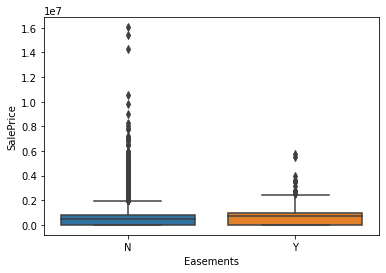

In [471]:
sns.boxplot(x='Easements', y="SalePrice", data=total_df, showfliers=True)

In [472]:
len(total_df)

25502

In [473]:
total_df.PropertyType.value_counts()

11    25502
Name: PropertyType, dtype: int64

In [474]:
total_df = total_df[total_df['SalePrice']!=0]

In [475]:
from geopy.geocoders import Nominatim
locator = Nominatim(user_agent='myGeocoder')
location = locator.geocode('2435  S  354TH                     ST       , KING COUNTY, WA, USA')
print('Latitude = {}, Longitude = {}'.format(location.latitude, location.longitude))

Latitude = 47.28493, Longitude = -122.30216590825634


In [476]:
# # 1 - conveneint function to delay between geocoding calls
# geocode = RateLimiter(locator.geocode, min_delay_seconds=1)
# # 2- - create location column
# total_df['location'] = total_df['address'].apply(geocode)
# # 3 - create longitude, laatitude and altitude from location column (returns tuple)
# total_df['point'] = total_df['location'].apply(lambda loc: tuple(loc.point)\
#                                                              if loc else None)
# # 4 - split point column into latitude, longitude and altitude columns
# total_df[['latitude', 'longitude', 'altitude']] = pd.DataFrame(total_df['point'].\
#                                                                       tolist(), index=total_df.\
#                                                                       index)

In [477]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date,address
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,AVE,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019,"12254 43RD AVE S, TUKWILA, WA, USA"
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,,LAKEVIEW,BLVD,E,98102,2,9,0,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0,0188000095,245005,018800,0095,Half of Duplex,ALLMOND ADD REPLAT,7,2,4,25,20,SE,R,13,3,NaN,NaN,SEATTLE,0010,LR2 (M),1,1,29,3117,2,2,4,1,1,0,0,0,False,0,0,0,0,0

Just by chance I noticed the first two columns are for the same address but have different prices, also the only difference between them is the sale warning category. let's take a look at this category more closely...

In [478]:
total_df.SaleWarning.value_counts()

               17380
15               242
26               201
40                99
41                93
10                51
15 51             49
15 46             45
51                43
46                38
15 26             25
12                17
56                16
18                14
15 40             13
54                13
15 56              9
12 15              9
34                 9
10 15              8
24                 6
10 56              6
35                 6
29                 5
5 51               5
18 51              4
15 36 56           4
15 26 46           4
49                 4
10 12              3
15 24              3
10 29              3
15 36              2
10 15 56           2
15 46 51           2
13 15              2
30                 2
26 46              2
15 18              2
60                 2
13                 2
18 22              2
12 15 51           1
15 18 51           1
46 56              1
3 26               1
12 15 46 58        1
13 23        

In [479]:
len(total_df[total_df['SaleWarning']==' '])

17380

In [480]:
len(total_df[total_df['SaleWarning']!=' '])

1111

In [481]:
total_df[total_df['SaleWarning']!=' ']['SalePrice'].mean()

684651.8811881188

In [482]:
total_df[total_df['SaleWarning']==' ']['SalePrice'].mean()

800842.2327387802

There is a clear difference in the average price of a home with a sale warning and a home without, this will be a feature worth keeping

In [483]:
total_df[total_df['Topography']=='0']['SalePrice'].mean()

768093.3268439007

In [484]:
total_df[total_df['Topography']=='1']['SalePrice'].mean()

1088088.315648086

Likewise with topography, making use of landscape either with man made or natural features appears to make a difference, I will keep this

<AxesSubplot:xlabel='WaterProblems', ylabel='SalePrice'>

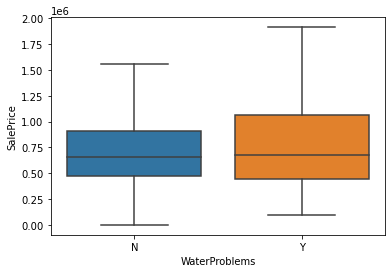

In [485]:
show_box(total_df, 'WaterProblems')

Water problems, homes with water problems seem to have higher prices, this makes no sense and due to uneven spread (only 70 in over 20,000) I will drop this column

In [486]:
for col in total_df.columns:
    print(col)
    print(total_df[col].value_counts())

Major_x
276760    79
814136    62
762570    53
510140    42
277060    42
          ..
131220     1
306560     1
228640     1
029379     1
545420     1
Name: Major_x, Length: 6579, dtype: int64
Minor_x
0040    354
0030    330
0020    322
0060    314
0010    298
       ... 
1721      1
3790      1
2432      1
2486      1
4480      1
Name: Minor_x, Length: 2453, dtype: int64
BldgNbr
1    18418
2       71
7        1
3        1
Name: BldgNbr, dtype: int64
NbrLivingUnits
1    18344
2      124
3       23
Name: NbrLivingUnits, dtype: int64
Address
                               14
15425   2ND AVE NE  98155       4
18203  SE 272ND ST   98042      4
3502   TROLL AVE N              3
4802  S 349TH ST   98001        2
                               ..
22031   123RD AVE SE  98031     1
15331  NE 65TH CT   98052       1
16519   116TH PL SE  98058      1
32138   37TH PL S  98001        1
4042   50TH AVE SW  98116       1
Name: Address, Length: 18318, dtype: int64
BuildingNumber
411      16
         1

GILMAN PARK ADD BLKS 01 THRU 47            79
SUNTOP PUD, DIVISION 1 - PHASE 2           62
MAPLE LEAF TO GREEN LAKE CIRCLE POR OF     60
SEA VIEW PARK                              53
GILMANS ADD BLKS 01 THRU 87                42
                                           ..
BEAVER LAKE ESTATES DIV III                 1
RASK EDWALL A ADD                           1
ESTATES AT SNOQUALMIE VALLEY TRAIL, THE     1
HILLSDALE                                   1
COVENANT BEACH ESTATES                      1
Name: PlatName, Length: 5998, dtype: int64
PlatLot_x
                  1913
1                  578
4                  573
3                  569
2                  553
                  ... 
3E &                 1
113-114              1
65 - 66              1
TR 331               1
2 AC 5               1
Name: PlatLot_x, Length: 1125, dtype: int64
PlatBlock_x
           10603
2           1089
1           1087
3            737
4            543
           ...  
68 &           1
79&          

Name: LandslideHazard, dtype: int64
SteepSlopeHazard
N    18491
Name: SteepSlopeHazard, dtype: int64
Stream
N    18491
Name: Stream, dtype: int64
Wetland
N    18491
Name: Wetland, dtype: int64
SpeciesOfConcern
N    18491
Name: SpeciesOfConcern, dtype: int64
SensitiveAreaTract
N    18491
Name: SensitiveAreaTract, dtype: int64
WaterProblems
N    18442
Y       49
Name: WaterProblems, dtype: int64
TranspConcurrency
N    18489
Y        2
Name: TranspConcurrency, dtype: int64
OtherProblems
N    18434
Y       57
Name: OtherProblems, dtype: int64
ExciseTaxNbr
3028365    2
3016210    1
3020678    1
3014945    1
3009383    1
          ..
2988201    1
3006515    1
3017183    1
2970391    1
2981537    1
Name: ExciseTaxNbr, Length: 18490, dtype: int64
Major
276760    79
814136    62
762570    53
510140    42
277060    42
          ..
131220     1
306560     1
228640     1
029379     1
545420     1
Name: Major, Length: 6579, dtype: int64
Minor
0040    354
0030    330
0020    322
0060    314
0010    

<AxesSubplot:xlabel='ViewUtilization', ylabel='SalePrice'>

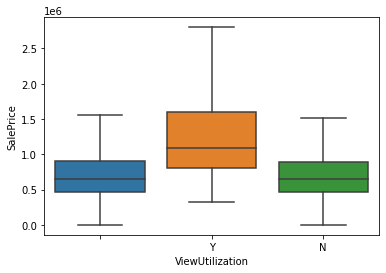

In [487]:
show_box(total_df, 'ViewUtilization')

Another feature worth keeping, although I will assume a blank entry is N.

<AxesSubplot:xlabel='ViewUtilization', ylabel='SalePrice'>

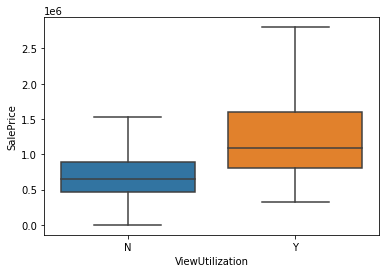

In [488]:
replace_val(total_df, 'ViewUtilization', ' ', 'N')

show_box(total_df, 'ViewUtilization')

That's better. Now I think all the columns worth keeping have been highlighted, its time to drop the rest, keeping some that I could be useful at some point - I don't know what I don't know yet!

In [489]:
cols_to_drop = ['Fraction','BldgGradeVar','AddnlCost', 'Unnamed: 0', 'Major_y', 'Minor_y', 'PropName', 'PlatName',\
               'PlatLot_x', 'PlatBlock_x', 'Range', 'SpecArea', 'SubArea', 'SpecSubArea', 'LevyCode', 'CurrentZoning',\
               'HBUAsIfVacant', 'HBUAsImproved', 'PresentUse','WaterSystem', 'SewerSystem', 'RestrictiveSzShape',\
               'PcntUnusable', 'WfntBank','WfntPoorQuality', 'WfntRestrictedAccess', 'WfntAccessRights',\
                'WfntProximityInfluence', 'TidelandShoreland','LotDepthFactor', 'AirportNoise',\
                'NbrBldgSites', 'Contamination', 'DNRLease','AdjacentGolfFairway', 'HistoricSite',\
                'CurrentUseDesignation', 'NativeGrowthProtEsmt', 'OtherDesignation', 'DeedRestrictions',\
                'DevelopmentRightsPurch', 'CoalMineHazard', 'CriticalDrainage','ErosionHazard', 'LandfillBuffer', \
                'HundredYrFloodPlain', 'SeismicHazard', 'LandslideHazard','SteepSlopeHazard','Stream', 'Wetland',\
                'SpeciesOfConcern', 'SensitiveAreaTract', 'WaterProblems', 'TranspConcurrency', 'OtherProblems','Volume','Page',\
                'PlatNbr', 'PlatType','PlatLot_y', 'PlatBlock_y', 'SellerName', 'BuyerName', 'PrincipalUse','SaleInstrument',\
                'AFForestLand', 'AFCurrentUseLand', 'AFNonProfitUse', 'AFHistoricProperty', 'SaleReason', \
               'NbrLivingUnits', 'SqFtUnfinFull', 'SqFtUnfinHalf','FpSingleStory','FpMultiStory','FpFreestanding','FpAdditional',\
               'PcntComplete','Obsolescence','PcntNetCondition', 'PropType', 'Unbuildable','StreetSurface', 'ExciseTaxNbr','Major',\
                'Minor', 'RecordingNbr', 'PropertyType', 'PropertyClass', 'Date']

In [490]:
total_df.drop(columns=cols_to_drop, inplace=True)

lets take a look at the new dataframe

In [491]:
total_df.head()

,Major_x,Minor_x,BldgNbr,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address
10,010050,0380,1,2435 S 354TH ST 98003,2435,S,354TH,ST,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,N,3,0,0,2,1994,0,5,0100500380,21,28,NE,55,KING COUNTY,6446,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,12/12/2019,445000,,"2435 S 354TH ST , KING COUNTY, WA, USA"
11,010050,0380,1,2435 S 354TH ST 98003,2435,S,354TH,ST,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,N,3,0,0,2,1994,0,5,0100500380,21,28,NE,55,KING COUNTY,6446,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,08/16/2019,311000,26,"2435 S 354TH ST , KING COUNTY, WA, USA"
17,017900,0315,1,12254 43RD AVE S 98178,12254,,43RD,AVE,S,98178,1,5,550,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,N,2,0,1,0,1942,0,3,0179000315,23,10,SE,24,TUKWILA,4000,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,12/05/2019,188500,,"12254 43RD AVE S, TUKWILA, WA, USA"
21,018800,0095,1,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,BLVD,E,98102,2,9,660,0,595,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,1984,0,3,0188000095,25,20,SE,13,SEATTLE,3117,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,3,N,N,N,N,08/30/2019,730000,,"1602 LAKEVIEW BLVD E, SEATTLE, WA, USA"
28,019110,0310,1,4520 88TH AVE SE 98040,4520,,88TH,AVE,SE,98040,1,8,1390,0,0,0,2780,1390,1390,7,0,0,Y,0,0,100,5,2,0,N,6,0,1,1,1967,0,3,0191100310,24,18,SW,34,MERCER ISLAND,9525,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,10/01/2019,1055700,,"4520 88TH AVE SE, MERCER ISLAND, WA, USA"


Ok, it is starting to take shape, I want to transform the yes no columns into ones and zeroes though for analysis.

In [492]:
cols_to_encode = ['PowerLines','OtherNuisances','AdjacentGreenbelt','Easements', 'DaylightBasement']
# lets check the value counts first

In [493]:
for col in cols_to_encode:
    total_df[col] = total_df[col].str.strip()
    print(total_df[col].value_counts())

N    18276
Y      215
Name: PowerLines, dtype: int64
N    17931
Y      560
Name: OtherNuisances, dtype: int64
N    17957
Y      534
Name: AdjacentGreenbelt, dtype: int64
N    18098
Y      393
Name: Easements, dtype: int64
N    7543
     6114
Y    4831
y       3
Name: DaylightBasement, dtype: int64


In [494]:
# clean columns so they are either Y or N
replace_val(total_df, 'DaylightBasement', '', 'N')
replace_val(total_df, 'DaylightBasement', 'y', 'Y')
for col in cols_to_encode:
    total_df[col] = total_df[col].str.strip()
    print(total_df[col].value_counts())

N    18276
Y      215
Name: PowerLines, dtype: int64
N    17931
Y      560
Name: OtherNuisances, dtype: int64
N    17957
Y      534
Name: AdjacentGreenbelt, dtype: int64
N    18098
Y      393
Name: Easements, dtype: int64
N    13657
Y     4834
Name: DaylightBasement, dtype: int64


In [495]:
# creating instance of labelencoder
labelencoder = LabelEncoder()
# Replacing Y/N with numerical
for col in cols_to_encode:
    total_df[col] = labelencoder.fit_transform(total_df[col])
    print(total_df[col].value_counts())

0    18276
1      215
Name: PowerLines, dtype: int64
0    17931
1      560
Name: OtherNuisances, dtype: int64
0    17957
1      534
Name: AdjacentGreenbelt, dtype: int64
0    18098
1      393
Name: Easements, dtype: int64
0    13657
1     4834
Name: DaylightBasement, dtype: int64


In [496]:
total_df['ViewUtilization'].value_counts()

N    18074
Y      417
Name: ViewUtilization, dtype: int64

In [497]:
total_df['ViewUtilization'] = labelencoder.fit_transform(total_df['ViewUtilization'])
total_df['ViewUtilization'].value_counts()

0    18074
1      417
Name: ViewUtilization, dtype: int64

In [498]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18491 entries, 10 to 251295
Data columns (total 68 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Major_x              18491 non-null  object
 1   Minor_x              18491 non-null  object
 2   BldgNbr              18491 non-null  object
 3   Address              18491 non-null  object
 4   BuildingNumber       18491 non-null  object
 5   DirectionPrefix      18477 non-null  object
 6   StreetName           18491 non-null  object
 7   StreetType           18491 non-null  object
 8   DirectionSuffix      18477 non-null  object
 9   ZipCode              16072 non-null  object
 10  Stories              18491 non-null  object
 11  BldgGrade            18491 non-null  object
 12  SqFt1stFloor         18491 non-null  object
 13  SqFtHalfFloor        18491 non-null  object
 14  SqFt2ndFloor         18491 non-null  object
 15  SqFtUpperFloor       18491 non-null  object
 16  Sq

I still need to convert alot of these columns before they will be usable in a model. 

In [499]:
for col in total_df.columns:
    print(total_df[col].value_counts())

276760    79
814136    62
762570    53
510140    42
277060    42
          ..
131220     1
306560     1
228640     1
029379     1
545420     1
Name: Major_x, Length: 6579, dtype: int64
0040    354
0030    330
0020    322
0060    314
0010    298
       ... 
1721      1
3790      1
2432      1
2486      1
4480      1
Name: Minor_x, Length: 2453, dtype: int64
1    18418
2       71
7        1
3        1
Name: BldgNbr, dtype: int64
                               14
15425   2ND AVE NE  98155       4
18203  SE 272ND ST   98042      4
3502   TROLL AVE N              3
4802  S 349TH ST   98001        2
                               ..
22031   123RD AVE SE  98031     1
15331  NE 65TH CT   98052       1
16519   116TH PL SE  98058      1
32138   37TH PL S  98001        1
4042   50TH AVE SW  98116       1
Name: Address, Length: 18318, dtype: int64
411      16
         16
415      15
306      13
126      12
         ..
11912     1
30104     1
12138     1
35408     1
6811      1
Name: BuildingNumber

0    18276
1      215
Name: PowerLines, dtype: int64
0    17931
1      560
Name: OtherNuisances, dtype: int64
0    17957
1      534
Name: AdjacentGreenbelt, dtype: int64
0    18098
1      393
Name: Easements, dtype: int64
06/25/2019    163
06/26/2019    153
06/18/2019    139
06/24/2019    136
07/09/2019    129
             ... 
03/17/2019      1
05/05/2019      1
11/24/2019      1
03/31/2019      1
01/27/2019      1
Name: DocumentDate, Length: 357, dtype: int64
450000      159
650000      157
400000      146
550000      136
700000      129
           ... 
855080        1
14250000      1
811000        1
1237000       1
1941500       1
Name: SalePrice, Length: 3496, dtype: int64
               17380
15               242
26               201
40                99
41                93
10                51
15 51             49
15 46             45
51                43
46                38
15 26             25
12                17
56                16
18                14
15 40             13

In [500]:
cols_to_int = ['SqFt1stFloor', 'SqFtHalfFloor', 'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',\
                'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement', 'SqFtGarageAttached', 'SqFtDeck', 'SqFtLot',\
               'Topography','WfntLocation', 'WfntFootage', 'MtRainier', 'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline',\
               'PugetSound','LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView', 'YrBuilt']

In [501]:
total_df.columns

Index(['Major_x', 'Minor_x', 'BldgNbr', 'Address', 'BuildingNumber',
       'DirectionPrefix', 'StreetName', 'StreetType', 'DirectionSuffix',
       'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor', 'SqFtHalfFloor',
       'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',
       'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement',
       'SqFtGarageAttached', 'DaylightBasement', 'SqFtOpenPorch',
       'SqFtEnclosedPorch', 'SqFtDeck', 'HeatSystem', 'HeatSource',
       'BrickStone', 'ViewUtilization', 'Bedrooms', 'BathHalfCount',
       'Bath3qtrCount', 'BathFullCount', 'YrBuilt', 'YrRenovated', 'Condition',
       'id', 'Township', 'Section', 'QuarterSection', 'Area', 'DistrictName',
       'SqFtLot', 'Access', 'Topography', 'InadequateParking', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'Traffi

It is starting to take shape and resemble something that could be useable for analysis, however, remembering this data was imported as string. I will need to convert columns that should be integer.

In [502]:
# convert columns to integer type
for col in cols_to_int:
    total_df[col] = total_df[col].astype(int)

In [503]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18491 entries, 10 to 251295
Data columns (total 68 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Major_x              18491 non-null  object
 1   Minor_x              18491 non-null  object
 2   BldgNbr              18491 non-null  object
 3   Address              18491 non-null  object
 4   BuildingNumber       18491 non-null  object
 5   DirectionPrefix      18477 non-null  object
 6   StreetName           18491 non-null  object
 7   StreetType           18491 non-null  object
 8   DirectionSuffix      18477 non-null  object
 9   ZipCode              16072 non-null  object
 10  Stories              18491 non-null  object
 11  BldgGrade            18491 non-null  object
 12  SqFt1stFloor         18491 non-null  int32 
 13  SqFtHalfFloor        18491 non-null  int32 
 14  SqFt2ndFloor         18491 non-null  int32 
 15  SqFtUpperFloor       18491 non-null  int32 
 16  Sq

In [504]:
#check for null values
total_df.isna().sum()

Major_x                   0
Minor_x                   0
BldgNbr                   0
Address                   0
BuildingNumber            0
DirectionPrefix          14
StreetName                0
StreetType                0
DirectionSuffix          14
ZipCode                2419
Stories                   0
BldgGrade                 0
SqFt1stFloor              0
SqFtHalfFloor             0
SqFt2ndFloor              0
SqFtUpperFloor            0
SqFtTotLiving             0
SqFtTotBasement           0
SqFtFinBasement           0
FinBasementGrade          0
SqFtGarageBasement        0
SqFtGarageAttached        0
DaylightBasement          0
SqFtOpenPorch             0
SqFtEnclosedPorch         0
SqFtDeck                  0
HeatSystem                0
HeatSource                0
BrickStone                0
ViewUtilization           0
Bedrooms                  0
BathHalfCount             0
Bath3qtrCount             0
BathFullCount             0
YrBuilt                   0
YrRenovated         

In [505]:
len(total_df)

18491

In [506]:
# checking duplicates where only the price has changed, if it has changed and nothing else has then this isn't useful and 
# one of them should be dropped
columns_check_duplicates = ['Major_x', 'Minor_x', 'BldgNbr', 'Address', 'BuildingNumber',
       'DirectionPrefix', 'StreetName', 'StreetType', 'DirectionSuffix',
       'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor', 'SqFtHalfFloor',
       'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',
       'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement',
       'SqFtGarageAttached', 'DaylightBasement', 'SqFtOpenPorch',
       'SqFtEnclosedPorch', 'SqFtDeck', 'HeatSystem', 'HeatSource',
       'BrickStone', 'ViewUtilization', 'Bedrooms', 'BathHalfCount',
       'Bath3qtrCount', 'BathFullCount', 'YrBuilt', 'YrRenovated', 'Condition',
       'id', 'Township', 'Section', 'QuarterSection', 'Area', 'DistrictName',
       'SqFtLot', 'Access', 'Topography', 'InadequateParking', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'TrafficNoise', 'PowerLines',
       'OtherNuisances', 'AdjacentGreenbelt', 'Easements', 'DocumentDate','SaleWarning', 'address']

In [507]:
# removing duplicates where only price has changed. keeping the highest value
total_df[total_df.sort_values('SalePrice').duplicated(subset=columns_check_duplicates, keep=False)]


<ipython-input-507-7c07cd8313d9>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  total_df[total_df.sort_values('SalePrice').duplicated(subset=columns_check_duplicates, keep=False)]


,Major_x,Minor_x,BldgNbr,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address
59507,312206,9048,1,18203 SE 272ND ST 98042,18203,SE,272ND,ST,,98042,1.5,6,970,420,0,0,1390,0,0,0,0,0,0,200,0,230,4,3,0,0,2,1,0,1,1946,0,3,3122069048,22,31,NW,56,KING COUNTY,45396,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,06/18/2019,1500,,"18203 SE 272ND ST , KING COUNTY, WA, USA"
59508,312206,9048,1,18203 SE 272ND ST 98042,18203,SE,272ND,ST,,98042,1.5,6,970,420,0,0,1390,0,0,0,0,0,0,200,0,230,4,3,0,0,2,1,0,1,1946,0,3,3122069048,22,31,NW,56,KING COUNTY,45396,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,06/18/2019,3600,,"18203 SE 272ND ST , KING COUNTY, WA, USA"
59509,312206,9048,1,18203 SE 272ND ST 98042,18203,SE,272ND,ST,,98042,1.5,6,970,420,0,0,1390,0,0,0,0,0,0,200,0,230,4,3,0,0,2,1,0,1,1946,0,3,3122069048,22,31,NW,56,KING COUNTY,45396,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,06/18/2019,35484,,"18203 SE 272ND ST , KING COUNTY, WA, USA"
183159,781280,0105,1,7469 S 116TH ST 98178,7469,S,116TH,ST,,98178,1,6,790,0,0,0,790,0,0,0,0,0,0,0,0,0,5,1,0,0,2,0,0,1,1944,0,3,7812800105,23,12,NW,25,KING COUNTY,7905,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06/25/2019,380000,,"7469 S 116TH ST , KING COUNTY, WA, USA"
183160,781280,0105,1,7469 S 116TH ST 98178,7469,S,116TH,ST,,98178,1,6,790,0,0,0,790,0,0,0,0,0,0,0,0,0,5,1,0,0,2,0,0,1,1944,0,3,7812800105,23,12,NW,25,KING COUNTY,7905,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06/25/2019,154000,,"7469 S 116TH ST , KING COUNTY, WA, USA"
203156,927420,3841,1,2008 A CALIFORNIA AVE SW,2008,,CALIFORNIA,AVE,SW,NaN,2,8,910,0,920,0,2340,890,510,7,380,0,0,60,0,0,5,2,0,1,3,1,0,3,2007,0,3,9274203841,24,11,NE,16,SEATTLE,2077,3,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,09/16/2019,872000,,"2008 CALIFORNIA AVE SW, SEATTLE, WA, USA"
203158,927420,3841,1,2008 A CALIFORNIA AVE SW,2008,,CALIFORNIA,AVE,SW,NaN,2,8,910,0,920,0,2340,890,510,7,380,0,0,60,0,0,5,2,0,1,3,1,0,3,2007,0,3,9274203841,24,11,NE,16,SEATTLE,2077,3,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,09/16/2019,875000,,"2008 CALIFORNIA AVE SW, SEATTLE, WA, USA"


In [508]:
# remove these duplicates so only the highest price is kept.
total_df = total_df.sort_values('SalePrice')
total_df.drop_duplicates(subset=columns_check_duplicates, keep='last', inplace=True)


appears to be a lot of zip codes missing, there may be a way to find these from the Address column

In [509]:
# lets make the SaleWarning column more user friendly
total_df.SaleWarning.value_counts()    


               17376
15               242
26               201
40                99
41                93
10                51
15 51             49
15 46             45
51                43
46                38
15 26             25
12                17
56                16
18                14
15 40             13
54                13
15 56              9
12 15              9
34                 9
10 15              8
10 56              6
24                 6
35                 6
29                 5
5 51               5
15 36 56           4
18 51              4
49                 4
15 26 46           4
15 24              3
10 12              3
10 29              3
15 36              2
15 18              2
13 15              2
18 22              2
60                 2
10 15 56           2
13                 2
30                 2
26 46              2
15 46 51           2
10 15 46           1
26 51              1
15 36 51           1
15 26 56           1
57                 1
15 22 51     

In [510]:
len(total_df[total_df['SaleWarning']== ' '])

17376

In [511]:
total_df.loc[total_df['SaleWarning']!= ' ', 'SaleWarning'] = 1
total_df.loc[total_df['SaleWarning'] == ' ', 'SaleWarning'] = 0
total_df.SaleWarning.value_counts()  

0    17376
1     1111
Name: SaleWarning, dtype: int64

Now it is time to map the columns that have references that are related to in the look up table provided. Replacing these numbers with their actual values will make the values easier to interpret when it comes to making them dummy variables 

In [512]:
# convert heat system column as per values in lookup table
heating_dict = get_dict(108, lookup_df)
total_df.HeatSystem = total_df.HeatSystem.str.strip().astype(int).map(heating_dict)
total_df.HeatSystem.value_counts()

Forced Air    14392
Heat Pump      1595
Elec BB        1150
Floor-Wall      565
Hot Water       461
Radiant         258
Gravity          38
Other            11
Name: HeatSystem, dtype: int64

In [516]:
heatsource_dict = get_dict(84, lookup_df)
total_df.HeatSource = total_df.HeatSource.str.strip().astype(int).map(heatsource_dict)
total_df.HeatSource.value_counts()

Gas                  13352
Electricity           3257
Oil                   1792
Gas/Solar               39
Other                   17
Electricity/Solar       11
Oil/Solar                3
Name: HeatSource, dtype: int64

lets review the status of the df now a lot has changed

In [517]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18487 entries, 62686 to 153622
Data columns (total 68 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Major_x              18487 non-null  object
 1   Minor_x              18487 non-null  object
 2   BldgNbr              18487 non-null  object
 3   Address              18487 non-null  object
 4   BuildingNumber       18487 non-null  object
 5   DirectionPrefix      18473 non-null  object
 6   StreetName           18487 non-null  object
 7   StreetType           18487 non-null  object
 8   DirectionSuffix      18473 non-null  object
 9   ZipCode              16069 non-null  object
 10  Stories              18487 non-null  object
 11  BldgGrade            18487 non-null  object
 12  SqFt1stFloor         18487 non-null  int32 
 13  SqFtHalfFloor        18487 non-null  int32 
 14  SqFt2ndFloor         18487 non-null  int32 
 15  SqFtUpperFloor       18487 non-null  int32 
 16 

In [525]:
for col in total_df.columns:
    print('\n')
    print(total_df[col].value_counts())
    print('\n')



276760    79
814136    62
762570    53
277060    42
510140    42
          ..
171190     1
720180     1
291100     1
809160     1
545420     1
Name: Major_x, Length: 6579, dtype: int64




0040    354
0030    330
0020    322
0060    314
0010    298
       ... 
3325      1
9286      1
0423      1
9411      1
3905      1
Name: Minor_x, Length: 2453, dtype: int64




1    18414
2       71
7        1
3        1
Name: BldgNbr, dtype: int64




                                  14
15425   2ND AVE NE  98155          4
3502   TROLL AVE N                 3
4035  NE 110TH ST   98125          2
308   EARLINGTON AVE SW  98057     2
                                  ..
10022   SLATER AVE NE  98033       1
1730  SW 347TH PL   98023          1
19439   107TH AVE SE  98055        1
5214  S 292ND ST   98001           1
26210  SE 158TH ST   98027         1
Name: Address, Length: 18318, dtype: int64




411      16
         16
415      15
306      13
126      12
         ..
22408     1
11830     1
2933 

some more tidying required. 

In [523]:
# convert wfntlocation to binary column
total_df.loc[total_df['WfntLocation']!= 0, 'WfntLocation'] = 1
total_df.WfntLocation.value_counts()


0    18192
1      295
Name: WfntLocation, dtype: int64

time to drop more columns

In [526]:
total_df.columns

Index(['Major_x', 'Minor_x', 'BldgNbr', 'Address', 'BuildingNumber',
       'DirectionPrefix', 'StreetName', 'StreetType', 'DirectionSuffix',
       'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor', 'SqFtHalfFloor',
       'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',
       'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement',
       'SqFtGarageAttached', 'DaylightBasement', 'SqFtOpenPorch',
       'SqFtEnclosedPorch', 'SqFtDeck', 'HeatSystem', 'HeatSource',
       'BrickStone', 'ViewUtilization', 'Bedrooms', 'BathHalfCount',
       'Bath3qtrCount', 'BathFullCount', 'YrBuilt', 'YrRenovated', 'Condition',
       'id', 'Township', 'Section', 'QuarterSection', 'Area', 'DistrictName',
       'SqFtLot', 'Access', 'Topography', 'InadequateParking', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'Traffi

In [527]:
more_drops = ['Major_x', 'Minor_x', 'BldgNbr', 'WfntFootage'] 
total_df.drop(columns=more_drops, inplace=True)


62686       0
157183    260
876         0
247014     40
188918      0
         ... 
145738      0
242620      0
246745      0
250369      0
153622      0
Name: SqFtEnclosedPorch, Length: 18487, dtype: int32

In [528]:
total_df['SqFtOpenPorch'] = total_df['SqFtOpenPorch'].str.strip().astype(int)
total_df['SqFtEnclosedPorch'] = total_df['SqFtEnclosedPorch'].str.strip().astype(int)

do access and inadequate parking, then make column for excellent view.

In [532]:
view_columns = ['MtRainier','Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound','LakeWashington',\
                'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView']
       
total_df[(total_df['MtRainier']==4)| (total_df['Olympics']==4) | (total_df['Cascades']==4) | (total_df['Territorial']==4)\
        | (total_df['SeattleSkyline']==4) | (total_df['PugetSound']==4) | (total_df['LakeWashington']==4) |\
        (total_df['LakeSammamish']==4)|(total_df['SmallLakeRiverCreek']==4) | (total_df['OtherView']==4)]

,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address
7464,10831 SE LAKE RD 98004,10831,SE,LAKE,RD,,98004,2,10,2100,0,2010,0,4110,430,0,0,0,870,1,1300,0,420,Forced Air,Gas,0,0,3,0,1,3,1959,2002,4,0824059113,24,8,SE,92,BELLEVUE,34625,4,0,2,3,0,0,4,0,0,3,0,0,0,1,3,0,0,0,0,02/15/2019,16082,1,"10831 SE LAKE RD , BELLEVUE, WA, USA"
10233,11065 SE LAKE RD 98004,11065,SE,LAKE,RD,,98004,2,10,2520,0,1780,0,3000,0,0,0,0,980,0,0,0,360,Forced Air,Gas,0,0,4,2,2,1,1957,0,5,0824059116,24,8,SE,92,BELLEVUE,27400,4,0,2,3,0,0,4,0,0,3,0,0,0,1,3,0,0,0,0,03/20/2019,17435,1,"11065 SE LAKE RD , BELLEVUE, WA, USA"
137867,30726 270TH AVE SE 98010,30726,,270TH,AVE,SE,98010,1,4,670,0,0,0,670,0,0,0,0,0,0,0,0,280,Elec BB,Electricity,0,0,1,0,0,0,1952,0,4,4080800155,21,12,NE,57,KING COUNTY,15152,4,1,0,0,0,0,0,0,0,0,0,4,0,1,0,0,0,0,0,05/28/2019,65000,0,"30726 270TH AVE SE, KING COUNTY, WA, USA"
26556,11610 DOLPHIN POINT TRL SW 98070,11610,,DOLPHIN POINT,TRL,SW,98070,1.5,6,770,230,0,0,820,0,0,0,0,0,0,0,0,250,Elec BB,Electricity,0,0,2,0,0,1,1977,0,3,0823039029,23,8,NW,100,KING COUNTY,28098,5,1,2,4,0,2,4,0,4,0,0,0,0,1,0,0,0,0,0,01/18/2019,200000,1,"11610 DOLPHIN POINT TRL SW, KING COUNTY, W..."
109312,31117 E LAKE MORTON DR SE 98042,31117,E,LAKE MORTON,DR,SE,98042,2,7,990,0,420,0,2190,780,780,7,0,0,1,0,0,210,Forced Air,Oil,0,0,3,1,0,1,1958,0,5,4053200255,21,8,NW,58,KING COUNTY,18890,4,0,0,0,0,0,2,0,0,0,0,4,0,1,0,0,0,0,0,02/06/2019,201000,0,"31117 E LAKE MORTON DR SE, KING COUNTY, WA..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92854,7406 N MERCER WAY 98040,7406,N,MERCER,WAY,,98040,1,10,430,0,0,0,810,380,380,10,0,0,0,0,0,0,Forced Air,Gas,0,0,1,0,0,1,2008,0,3,5315100085,24,1,SW,34,MERCER ISLAND,21793,4,0,2,0,0,0,4,0,0,4,0,0,3,1,0,0,0,0,0,02/22/2019,7200000,0,"7406 N MERCER WAY , MERCER ISLAND, WA, USA"
207747,2237 EVERGREEN POINT RD 98039,2237,,EVERGREEN POINT,RD,,98039,2,12,1620,0,1620,0,4575,1335,1335,11,0,0,1,70,0,756,Forced Air,Gas,0,0,4,1,1,3,2000,0,3,9208900009,25,25,NW,33,MEDINA,34092,4,1,0,0,0,0,3,0,0,4,0,0,0,1,0,0,0,0,0,08/16/2019,8250000,0,"2237 EVERGREEN POINT RD , MEDINA, WA, USA"
242620,3054 E LAURELHURST DR NE 98105,3054,E,LAURELHURST,DR,NE,98105,2,13,2700,0,2450,0,6830,3140,1680,10,680,0,1,170,0,490,Hot Water,Gas,100,0,4,1,3,2,1928,0,5,4217402315,25,15,SE,46,SEATTLE,40463,4,1,2,3,0,3,3,0,0,4,0,0,0,1,0,0,0,0,0,09/25/2019,10580000,0,"3054 E LAURELHURST DR NE, SEATTLE, WA, USA"
250369,4601 91ST PL NE 98004,4601,,91ST,PL,NE,98004,2,13,3510,0,1730,0,6020,880,780,10,0,500,0,380,0,40,Forced Air,Gas,0,0,4,1,2,2,1925,1990,4,9808100030,25,18,SW,33,YARROW POINT,50243,4,0,0,0,0,0,2,0,0,4,0,0,0,1,0,0,0,0,0,08/01/2019,15425000,0,"4601 91ST PL NE, YARROW POINT, WA, USA"


In [533]:
total_df['excellent_view'] = 0

In [534]:
total_df.loc[(total_df['MtRainier']==4)| (total_df['Olympics']==4) | (total_df['Cascades']==4) | (total_df['Territorial']==4)\
        | (total_df['SeattleSkyline']==4) | (total_df['PugetSound']==4) | (total_df['LakeWashington']==4) |\
        (total_df['LakeSammamish']==4)|(total_df['SmallLakeRiverCreek']==4) | (total_df['OtherView']==4), 'excellent_view'] = 1

created a new column just for excellent views, I will now make the rest of the view columns binary. 

In [535]:
total_df.head()

,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address,excellent_view
62686,17701 185TH AVE NE 98072,17701,,185TH,AVE,NE,98072,1,7,750,0,0,0,1500,750,750,7,0,0,1,0,0,520,Forced Air,Electricity,0,0,3,1,0,1,1977,0,5,1630700286,26,7,NW,36,KING COUNTY,14494,4,1,2,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,06/03/2019,10,0,"17701 185TH AVE NE, KING COUNTY, WA, USA",0
157183,9508 167TH AVE NE 98052,9508,,167TH,AVE,NE,98052,1,7,1290,0,0,0,1290,0,0,0,0,300,0,0,260,0,Elec BB,Electricity,0,0,3,0,0,2,1967,0,4,6138400450,25,1,NW,72,REDMOND,9687,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06/08/2019,1000,1,"9508 167TH AVE NE, REDMOND, WA, USA",0
876,19361 61ST AVE NE 98028,19361,,61ST,AVE,NE,98028,2,7,1470,0,490,0,1960,0,0,0,0,310,0,0,0,160,Forced Air,Gas,0,0,3,0,1,2,1958,0,4,0226049046,26,2,SW,38,KENMORE,16183,4,0,2,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,08/01/2019,1500,1,"19361 61ST AVE NE, KENMORE, WA, USA",0
247014,15915 VASHON HWY SW 98070,15915,,VASHON,HWY,SW,98070,1,7,1330,0,0,0,1330,0,0,0,0,0,0,0,40,180,Floor-Wall,Oil,0,0,3,0,0,1,1950,0,4,1923039062,23,19,SE,100,KING COUNTY,35283,4,0,2,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,05/02/2019,1500,1,"15915 VASHON HWY SW, KING COUNTY, WA, USA",0
188918,10616 SW 133RD ST 98070,10616,SW,133RD,ST,,98070,1,6,480,0,0,0,480,0,0,0,0,0,0,0,0,0,Floor-Wall,Electricity,0,0,1,0,1,0,1991,0,3,1823039065,23,18,NE,100,KING COUNTY,37927,4,0,2,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,03/25/2019,1500,1,"10616 SW 133RD ST , KING COUNTY, WA, USA",0


In [536]:
for col in view_columns:
    total_df.loc[total_df[col]!= 0, col] = 1

In [537]:
total_df.Access.value_counts()

4    17329
3     1120
1       18
5       11
0        7
2        2
Name: Access, dtype: int64

In [539]:
access_dict = get_dict(55, lookup_df)
access_dict

{1: 'RESTRICTED',
 2: 'LEGAL/UNDEVELOPED',
 3: 'PRIVATE',
 4: 'PUBLIC',
 5: 'WALK IN'}

In [540]:
total_df.Access = total_df.Access.str.strip().astype(int).map(access_dict)

In [541]:
total_df.Access.value_counts()

PUBLIC               17329
PRIVATE               1120
RESTRICTED              18
WALK IN                 11
LEGAL/UNDEVELOPED        2
Name: Access, dtype: int64

In [542]:
total_df.InadequateParking.value_counts()

2    11477
0     6992
1       18
Name: InadequateParking, dtype: int64

I am going to make an assumption that since 2 represents aqequate parking that 0 and 1 will represent inadequate parking

In [544]:
replace_val(total_df, 'InadequateParking', '1', 0)
total_df.InadequateParking.value_counts()

2    11477
0     6992
0       18
Name: InadequateParking, dtype: int64

In [546]:
replace_val(total_df, 'InadequateParking', '0', 0)
replace_val(total_df, 'InadequateParking', '1', 0)
replace_val(total_df, 'InadequateParking', '2', 1)
total_df.InadequateParking.value_counts()

1    11477
0     7010
Name: InadequateParking, dtype: int64

I will now join the table I created to get latitude and longitude information

In [554]:
longslats_df = pd.read_csv('longslats.csv', dtype='str')

In [555]:
longslats_df = longslats_df[['id', 'latitude', 'longitude']]

In [550]:
total_df.to_csv('pre-merge.csv')

In [556]:
total_df = total_df.merge(longslats_df, how='left', on='id')

In [558]:
total_df['latitude'] = total_df['latitude'].astype(float)
total_df['longitude'] = total_df['longitude'].astype(float)

In [559]:
total_df.isna().sum()

Address                   0
BuildingNumber            0
DirectionPrefix          14
StreetName                0
StreetType                0
DirectionSuffix          14
ZipCode                2441
Stories                   0
BldgGrade                 0
SqFt1stFloor              0
SqFtHalfFloor             0
SqFt2ndFloor              0
SqFtUpperFloor            0
SqFtTotLiving             0
SqFtTotBasement           0
SqFtFinBasement           0
FinBasementGrade          0
SqFtGarageBasement        0
SqFtGarageAttached        0
DaylightBasement          0
SqFtOpenPorch             0
SqFtEnclosedPorch         0
SqFtDeck                  0
HeatSystem               17
HeatSource               16
BrickStone                0
ViewUtilization           0
Bedrooms                  0
BathHalfCount             0
Bath3qtrCount             0
BathFullCount             0
YrBuilt                   0
YrRenovated               0
Condition                 0
id                        0
Township            

In [560]:
len(total_df)

18797

In [564]:
total_df.dropna(subset=['ZipCode'], inplace=True)

In [565]:
len(total_df)

16356

In [566]:
total_df.isna().sum()

Address                  0
BuildingNumber           0
DirectionPrefix          0
StreetName               0
StreetType               0
DirectionSuffix          0
ZipCode                  0
Stories                  0
BldgGrade                0
SqFt1stFloor             0
SqFtHalfFloor            0
SqFt2ndFloor             0
SqFtUpperFloor           0
SqFtTotLiving            0
SqFtTotBasement          0
SqFtFinBasement          0
FinBasementGrade         0
SqFtGarageBasement       0
SqFtGarageAttached       0
DaylightBasement         0
SqFtOpenPorch            0
SqFtEnclosedPorch        0
SqFtDeck                 0
HeatSystem              16
HeatSource              16
BrickStone               0
ViewUtilization          0
Bedrooms                 0
BathHalfCount            0
Bath3qtrCount            0
BathFullCount            0
YrBuilt                  0
YrRenovated              0
Condition                0
id                       0
Township                 0
Section                  0
Q

In [567]:
total_df.dropna(subset=['latitude', 'longitude', 'HeatSource', 'HeatSystem', 'Access'], inplace=True)

In [568]:
len(total_df)

16131

In [569]:
total_df.isna().sum()

Address                0
BuildingNumber         0
DirectionPrefix        0
StreetName             0
StreetType             0
DirectionSuffix        0
ZipCode                0
Stories                0
BldgGrade              0
SqFt1stFloor           0
SqFtHalfFloor          0
SqFt2ndFloor           0
SqFtUpperFloor         0
SqFtTotLiving          0
SqFtTotBasement        0
SqFtFinBasement        0
FinBasementGrade       0
SqFtGarageBasement     0
SqFtGarageAttached     0
DaylightBasement       0
SqFtOpenPorch          0
SqFtEnclosedPorch      0
SqFtDeck               0
HeatSystem             0
HeatSource             0
BrickStone             0
ViewUtilization        0
Bedrooms               0
BathHalfCount          0
Bath3qtrCount          0
BathFullCount          0
YrBuilt                0
YrRenovated            0
Condition              0
id                     0
Township               0
Section                0
QuarterSection         0
Area                   0
DistrictName           0


In [570]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16131 entries, 0 to 18796
Data columns (total 67 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Address              16131 non-null  object 
 1   BuildingNumber       16131 non-null  object 
 2   DirectionPrefix      16131 non-null  object 
 3   StreetName           16131 non-null  object 
 4   StreetType           16131 non-null  object 
 5   DirectionSuffix      16131 non-null  object 
 6   ZipCode              16131 non-null  object 
 7   Stories              16131 non-null  object 
 8   BldgGrade            16131 non-null  object 
 9   SqFt1stFloor         16131 non-null  int32  
 10  SqFtHalfFloor        16131 non-null  int32  
 11  SqFt2ndFloor         16131 non-null  int32  
 12  SqFtUpperFloor       16131 non-null  int32  
 13  SqFtTotLiving        16131 non-null  int32  
 14  SqFtTotBasement      16131 non-null  int32  
 15  SqFtFinBasement      16131 non-null 

In [577]:
#drop duplicates with same address and same price
total_df.drop_duplicates(subset=['Address', 'SalePrice'], keep='last', inplace=True)

In [578]:
total_df.to_csv('cleaned_data.csv')

that was hard work, a lot of columns required attention but now its time to start modelling.
This data will require further cleaning iterations and feature engineering but this is a good starting point

In [579]:
#Create base map zoomed in to seattle
map3=folium.Map(location=[47.5837012,-122.3984634],  tiles=None, zoom_start=7)
folium.TileLayer('cartodbpositron', name='King County House Prices').add_to(map3)

#Make Marker Cluster Group layer
mcg = folium.plugins.MarkerCluster(control=False)
map3.add_child(mcg)

#Create layer of markers
#Set marker popups to display name and address of service
for row in total_df.iterrows():
    row_values=row[1]
    location=[row_values['latitude'], row_values['longitude']]
    popup=popup=('$' + str(row_values['SalePrice'])+'<br>'+'<br>'+ row_values['Address']+
                 '<br>'+'<br>'+row_values['DistrictName'])
    marker=folium.Marker(location=location, popup=popup, min_width=2000)
    marker.add_to(mcg)

#Add layer control
folium.LayerControl().add_to(map3)

map3